# ADS-B Aircraft Projection

This notebook upsamples aircraft position data to 1-second intervals using linear interpolation.

In [439]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')

In [440]:
base_dir = '/Users/shrenikborad/Downloads/NNDL/adsb_data_uwisc/2025-10-01/'
time_filter = (datetime(2025, 10, 1, 3, 0, 0), datetime(2025, 10, 1, 4, 0, 0)) # 3 AM to 4 AM in CDT


In [441]:
# Load the data
df = pd.read_csv('adsb_flightpings_wisconsin_oct1_2025.csv')
df.columns = df.columns.str.strip()
# Helper to clean numeric-like text
def clean_numeric(s: pd.Series) -> pd.Series:
    # convert to string, strip whitespace
    s = s.astype(str).str.strip()
    # make empty strings into NaN
    s = s.replace({'': np.nan})
    # remove commas and any stray spaces
    s = s.str.replace(',', '', regex=False).str.replace(' ', '', regex=False)
    # finally, coerce to numeric
    return pd.to_numeric(s, errors='coerce')

# Clean and convert numeric columns
for col in ['alt_gnss_meters', 'distance_m']:
    if col in df.columns:
        df[col] = clean_numeric(df[col])
# Strip whitespace from column names

df = df.dropna(subset=['alt_gnss_meters'])
# Convert time to datetime
df['time'] = pd.to_datetime(df['time'])
# drop rows with missing alt_gnss_meters
df = df.dropna(subset=['alt_gnss_meters'])
# convert to float
df['alt_gnss_meters'] = df['alt_gnss_meters'].astype(float)
df['distance_m'] = df['distance_m'].astype(float)
# distance_m should be less than 50 km and altitude should be above 8000 feet (2438.4 meters)
df = df[(df['alt_gnss_meters'] > 2438.4)]

# Display basic info
print(f"Total rows: {len(df)}")
print(f"Unique aircraft (ident): {df['ident'].nunique()}")
print(f"\nColumns: {df.columns.tolist()}")
print(f"\nFirst few rows:")
df.head()

Total rows: 22188
Unique aircraft (ident): 813

Columns: ['source_id', 'source', 'transponder_id', 'orig', 'dest', 'ident', 'aircraft_type', 'time', 'lon', 'lat', 'alt', 'alt_gnss', 'heading', 'on_ground', 'alt_meters', 'alt_gnss_meters', 'clock_datetime', 'distance_m']

First few rows:


,source_id,source,transponder_id,orig,dest,ident,aircraft_type,time,lon,lat,alt,alt_gnss,heading,on_ground,alt_meters,alt_gnss_meters,clock_datetime,distance_m
0,c421f98a-4e93-46f6-af06-1a5a78458b0b,contrails-api,8694B6,RJTT,KORD,ANA112,B77W,2025-10-01 13:00:00+00:00,-88.694,42.383,10800.0,11400.0,,False,3291.84,3474.72,2025-10-01 13:00:00+00:00,96175.960812
1,c421f98a-4e93-46f6-af06-1a5a78458b0b,contrails-api,8694B6,RJTT,KORD,ANA112,B77W,2025-10-01 13:00:32+00:00,-88.636,42.376,10725.0,11300.0,,False,3268.98,3444.24,2025-10-01 13:00:32+00:00,99733.816282
2,88dd2009-538c-4ff5-837e-a56bde8789f2,contrails-api,780D8F,PANC,KORD,CAO1009,B77L,2025-10-01 13:02:30+00:00,-88.608,43.752,25100.0,26250.0,,False,7650.48,8001.00,2025-10-01 13:02:30+00:00,99538.060416
3,88dd2009-538c-4ff5-837e-a56bde8789f2,contrails-api,780D8F,PANC,KORD,CAO1009,B77L,2025-10-01 13:03:01+00:00,-88.635,43.687,24675.0,25800.0,,False,7520.94,7863.84,2025-10-01 13:03:01+00:00,92700.372139
4,88dd2009-538c-4ff5-837e-a56bde8789f2,contrails-api,780D8F,PANC,KORD,CAO1009,B77L,2025-10-01 13:03:32+00:00,-88.660,43.629,24275.0,25400.0,,False,7399.02,7741.92,2025-10-01 13:03:32+00:00,86644.056739


In [442]:
# check if alt_gnss_meters columns have missing values
if df['alt_gnss_meters'].isnull().any():
    print("alt_gnss_meters column has missing values.")
else:
    print("alt_gnss_meters column has no missing values.")

alt_gnss_meters column has no missing values.


In [443]:
# Check time intervals for a sample aircraft
sample_ident = df['ident'].iloc[0]
sample_df = df[df['ident'] == sample_ident].copy()
sample_df = sample_df.sort_values('time')
sample_df['time_diff'] = sample_df['time'].diff().dt.total_seconds()

print(f"Sample aircraft: {sample_ident}")
print(f"Number of records: {len(sample_df)}")
print(f"\nTime interval statistics (seconds):")
print(sample_df['time_diff'].describe())
print(f"\nFirst few records:")
sample_df[['time', 'lon', 'lat', 'alt', 'time_diff']].head(10)

Sample aircraft:  ANA112  
Number of records: 2

Time interval statistics (seconds):
count     1.0
mean     32.0
std       NaN
min      32.0
25%      32.0
50%      32.0
75%      32.0
max      32.0
Name: time_diff, dtype: float64

First few records:


,time,lon,lat,alt,time_diff
0,2025-10-01 13:00:00+00:00,-88.694,42.383,10800.0,NaN
1,2025-10-01 13:00:32+00:00,-88.636,42.376,10725.0,32.0


In [444]:
def upsample_aircraft(group):
    """
    Upsample a single aircraft's data to 1-second intervals using linear interpolation.
    Adds an 'isUpsampled' column to indicate interpolated vs original data.
    """
    # Sort by time
    group = group.sort_values('time').reset_index(drop=True)
    
    # Mark original data as not upsampled
    group['isUpsampled'] = False
    
    # Get time range
    start_time = group['time'].min()
    end_time = group['time'].max()
    
    # Create 1-second intervals
    time_range = pd.date_range(start=start_time, end=end_time, freq='1S')
    
    # Create new dataframe with all seconds
    new_df = pd.DataFrame({'time': time_range})
    
    # Merge with original data
    merged = new_df.merge(group, on='time', how='left')
    
    # Convert numeric columns to proper float dtype BEFORE interpolation
    numeric_cols_to_interpolate = ['lon', 'lat', 'alt', 'alt_gnss', 'heading', 
                                     'alt_meters', 'alt_gnss_meters', 'distance_m']
    
    for col in numeric_cols_to_interpolate:
        if col in merged.columns:
            # Convert to numeric, forcing errors to NaN
            merged[col] = pd.to_numeric(merged[col], errors='coerce')
            # Interpolate
            merged[col] = merged[col].interpolate(method='linear', limit_area='inside')
    
    # Fill isUpsampled: True for interpolated rows, False for original
    merged['isUpsampled'] = merged['isUpsampled'].fillna(True)

    # Forward fill categorical/string columns (like ident, aircraft_type, etc.)
    categorical_cols = ['source_id', 'source', 'transponder_id', 'orig', 'dest', 
                       'ident', 'aircraft_type', 'clock_datetime']
    
    for col in categorical_cols:
        if col in merged.columns:
            merged[col] = merged[col].fillna(method='ffill')

    return merged

In [445]:
# Test upsampling on a single aircraft first
test_ident = df['ident'].iloc[0]
test_group = df[df['ident'] == test_ident].copy()

print(f"Testing upsampling for aircraft: {test_ident}")
print(f"Original records: {len(test_group)}")

test_upsampled = upsample_aircraft(test_group)

print(f"Upsampled records: {len(test_upsampled)}")
print(f"Original data points: {(~test_upsampled['isUpsampled']).sum()}")
print(f"Interpolated data points: {test_upsampled['isUpsampled'].sum()}")
print(f"\nFirst 100 rows (showing interpolation):")
test_upsampled[['ident', 'time', 'lon', 'lat', 'alt_meters','alt_gnss_meters', 'isUpsampled']].head(100)

Testing upsampling for aircraft:  ANA112  
Original records: 2
Upsampled records: 33
Original data points: 2
Interpolated data points: 31

First 100 rows (showing interpolation):


,ident,time,lon,lat,alt_meters,alt_gnss_meters,isUpsampled
0,ANA112,2025-10-01 13:00:00+00:00,-88.694000,42.383000,3291.840000,3474.7200,False
1,ANA112,2025-10-01 13:00:01+00:00,-88.692188,42.382781,3291.125625,3473.7675,True
2,ANA112,2025-10-01 13:00:02+00:00,-88.690375,42.382563,3290.411250,3472.8150,True
3,ANA112,2025-10-01 13:00:03+00:00,-88.688563,42.382344,3289.696875,3471.8625,True
4,ANA112,2025-10-01 13:00:04+00:00,-88.686750,42.382125,3288.982500,3470.9100,True
5,ANA112,2025-10-01 13:00:05+00:00,-88.684938,42.381906,3288.268125,3469.9575,True
6,ANA112,2025-10-01 13:00:06+00:00,-88.683125,42.381687,3287.553750,3469.0050,True
7,ANA112,2025-10-01 13:00:07+00:00,-88.681313,42.381469,3286.839375,3468.0525,True
8,ANA112,2025-10-01 13:00:08+00:00,-88.679500,42.381250,3286.125000,3467.1000,True
9,ANA112,2025-10-01 13:00:09+00:00,-88.677688,42.381031,3285.410625,3466.1475,True


In [446]:
# Upsample all aircraft
print("Upsampling all aircraft...")
# filter for 3 pm utc to 4 pm utc
print(f"Processing {df['ident'].nunique()} unique aircraft...\n")

# Group by ident and apply upsampling
upsampled_groups = []
for ident, group in df.groupby('ident'):
    upsampled = upsample_aircraft(group)
    upsampled_groups.append(upsampled)
    if len(upsampled_groups) % 10 == 0:
        print(f"Processed {len(upsampled_groups)} aircraft...")

# Combine all upsampled data
df_upsampled = pd.concat(upsampled_groups, ignore_index=True)
df_upsampled = df_upsampled.sort_values(['ident', 'time']).reset_index(drop=True)
df_upsampled= df_upsampled[df_upsampled["distance_m"] < 50000]
print(f"\nUpsampling complete!")
print(f"Original total records: {len(df)}")
print(f"Upsampled total records: {len(df_upsampled)}")
print(f"Original data points: {(~df_upsampled['isUpsampled']).sum()}")
print(f"Interpolated data points: {df_upsampled['isUpsampled'].sum()}")

Upsampling all aircraft...
Processing 813 unique aircraft...

Processed 10 aircraft...
Processed 20 aircraft...
Processed 30 aircraft...
Processed 40 aircraft...
Processed 50 aircraft...
Processed 60 aircraft...
Processed 70 aircraft...
Processed 80 aircraft...
Processed 90 aircraft...
Processed 100 aircraft...
Processed 110 aircraft...
Processed 120 aircraft...
Processed 130 aircraft...
Processed 140 aircraft...
Processed 150 aircraft...
Processed 160 aircraft...
Processed 170 aircraft...
Processed 180 aircraft...
Processed 190 aircraft...
Processed 200 aircraft...
Processed 210 aircraft...
Processed 220 aircraft...
Processed 230 aircraft...
Processed 240 aircraft...
Processed 250 aircraft...
Processed 260 aircraft...
Processed 270 aircraft...
Processed 280 aircraft...
Processed 290 aircraft...
Processed 300 aircraft...
Processed 310 aircraft...
Processed 320 aircraft...
Processed 330 aircraft...
Processed 340 aircraft...
Processed 350 aircraft...
Processed 360 aircraft...
Processed 3

In [447]:
from pyproj import Transformer, CRS
import numpy as np
import cv2
import pymap3d as pm


def ecef_to_enu(origin_ecef, points_ecef):

    # use pymap3d to convert ecef to enu
    enu_points = pm.ecef2enu(points_ecef[:, 0], points_ecef[:, 1], points_ecef[:, 2],
                              origin_ecef[0], origin_ecef[1], origin_ecef[2])
    # make numpy array
    return np.array(enu_points).T


def gps_to_camxy_vasha_fixed(lats, lons, alts, cam_ecef, cam_k, cam_r, cam_t, camera_gps, distortion=None):
    """
    Fixed version of GPS to camera coordinates conversion.
    Properly handles objects behind camera and outside frame.
    """
    # Convert GPS to ECEF
    transformer_geodetic_to_ecef = Transformer.from_crs(
        "epsg:4979", "epsg:4978", always_xy=True)
    eX, eY, eZ = transformer_geodetic_to_ecef.transform(lons, lats, alts)
    ecef_points = np.column_stack((eX, eY, eZ))

    # Convert ECEF to ENU relative to camera
    enu_points = ecef_to_enu(
        camera_gps, ecef_points)  # Shape: (N, 3)

    # CRITICAL FIX 1: Transform to camera coordinate system properly
    # Camera coordinates: X=right, Y=down, Z=forward (into scene)
    points_cam = (cam_r @ enu_points.T + cam_t).T  # Shape: (N, 3)

    # CRITICAL FIX 2: Filter out points behind camera BEFORE projection
    # Points with negative Z are behind the camera
    behind_camera_mask = points_cam[:, 2] <= 0

    # Initialize output arrays
    num_points = len(lats)
    image_x = np.full(num_points, np.nan)
    image_y = np.full(num_points, np.nan)
    cam_distance = points_cam[:, 2]  # Z coordinate is the distance

    # Only project points in front of camera
    if np.any(~behind_camera_mask):
        valid_points = enu_points[~behind_camera_mask]

        # Project using OpenCV
        rvec, _ = cv2.Rodrigues(cam_r)
        tvec = cam_t.astype(np.float32)

        if distortion is None:
            distortion = np.zeros((5, 1), dtype=np.float32)

        image_points, _ = cv2.projectPoints(
            valid_points.astype(np.float32),
            rvec, tvec, cam_k, distortion
        )
        image_points = image_points.reshape(-1, 2)

        # Assign projected coordinates back to output arrays
        valid_indices = np.where(~behind_camera_mask)[0]
        image_x[valid_indices] = image_points[:, 0]
        image_y[valid_indices] = image_points[:, 1]

    return image_x, image_y, cam_distance

def gps_to_ecef(points_gps):
    transformer_geodetic_to_ecef = Transformer.from_crs(
        "epsg:4979", "epsg:4978", always_xy=True)
    eX, eY, eZ = transformer_geodetic_to_ecef.transform(
        points_gps[:, 1], points_gps[:, 0], points_gps[:, 2])
    ecef_points = np.vstack((eX, eY, eZ)).T  # Shape: (N, 3)
    return ecef_points

def estimate_camera_params(origin_gps, poi_ecef, poi_xy, frame_size, intrinsics_estimate=None, distortion_estimate=None, rvecs=None, tvecs=None):
    # Convert camera GPS coordinates to ECEF
    transformer_geodetic_to_ecef = Transformer.from_crs(
        "epsg:4979", "epsg:4978", always_xy=True)
    # Note: pyproj expects lon,lat,alt order
    eX, eY, eZ = transformer_geodetic_to_ecef.transform(
        origin_gps[1], origin_gps[0], origin_gps[2])
    cam_ecef = np.array([eX, eY, eZ]).T  # /1000  # Shape: (3,)
    # eX, eY, eZ = transformer_geodetic_to_ecef.transform(
    #     poi_gps[:, 1], poi_gps[:, 0], poi_gps[:, 2])
    # poi_ecef = np.vstack((eX, eY, eZ)).T  # /1000  # Shape: (3, N)
    poi_enu = ecef_to_enu(
        origin_gps, poi_ecef)  # Shape: (N,3)

    # Put everything in contiguous arrays with (N, 3), not (3, N)
    object_points = np.ascontiguousarray(poi_enu.astype(np.float32))  # (N, 3)
    image_points = np.ascontiguousarray(
        poi_xy.astype(np.float32))      # (N, 2)

    if intrinsics_estimate is None:
        estimated_focal_dist = 1e5
        intrinsics_estimate = np.array([[estimated_focal_dist, 0, frame_size[1] / 2],
                                        [0, estimated_focal_dist,
                                            frame_size[0] / 2],
                                        [0, 0, 1]], dtype=np.float32)  # (3, 3)
    if distortion_estimate is None:
        # Use a zero distortion model if not provided
        distortion_estimate = np.zeros((5, 1), dtype=np.float32)

    criteria = (
        cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER,
        10000,    # Maximum 10,000 iterations (vs default ~30)
        1e-12     # Extremely tight convergence (vs default 1e-6)
    )
    print("Initial intrinsics:\n", intrinsics_estimate)
    print("Initial distortion:\n", distortion_estimate.ravel())
    calibrate_flags = (
        cv2.CALIB_USE_INTRINSIC_GUESS |         # Use your good initial guess
        # cv2.CALIB_USE_LU |                    # Use your good initial guess
        cv2.CALIB_FIX_PRINCIPAL_POINT  |        # Keep principal point fixed
        # cv2.CALIB_FIX_FOCAL_LENGTH |          # Keep focal lengths fixed
        cv2.CALIB_FIX_ASPECT_RATIO |            # Keep fx/fy ratio fixed
        # cv2.CALIB_FIX_K1 |
        # cv2.CALIB_FIX_K2 | 
        # cv2.CALIB_FIX_K3 |      # keep all c
        # cv2.CALIB_FIX_P1 | 
        # CALIB_FIX_P2 |  #fix tangential distortion
        # fix higher order radial distortions
        cv2.CALIB_FIX_K4 | cv2.CALIB_FIX_K5 | cv2.CALIB_FIX_K6 |
        cv2.CALIB_ZERO_TANGENT_DIST           # Only estimate radial distortion
        | cv2.CALIB_USE_EXTRINSIC_GUESS
    )
    # Let OpenCV estimate all distortion parameters
    ret, camera_matrix, dist_coeffs, rvecs, tvecs = cv2.calibrateCamera(
        [object_points], [image_points], frame_size,
        intrinsics_estimate,
        distortion_estimate,
        rvecs,
        tvecs,
        flags=calibrate_flags,
        criteria=criteria
    )

    T = tvecs[0]  # .reshape(3, 1)  # Reshape to (3, 1)
    R, _ = cv2.Rodrigues(rvecs[0])

    return camera_matrix, dist_coeffs, R, T, cam_ecef


def calculate_fov_from_intrinsics(intrinsics, image_width, image_height, distortion=None):
    """
    Calculate horizontal and vertical field of view from camera intrinsics matrix.

    *** NOTE: This method assumes no distortion is applied.
    Without distortion -  ***

    Args:
        intrinsics: 3x3 camera intrinsics matrix (K matrix)
        image_width: Width of the image in pixels
        image_height: Height of the image in pixels
        distortion: Optional distortion coefficients (not used in this calculation)

    Returns:
        hfov: Horizontal field of view in radians
        vfov: Vertical field of view in radians
        hfov_deg: Horizontal field of view in degrees
        vfov_deg: Vertical field of view in degrees
    """
    # Extract focal lengths and principal point
    fx = intrinsics[0, 0]  # focal length in x (pixels)
    fy = intrinsics[1, 1]  # focal length in y (pixels)
    cx = intrinsics[0, 2]  # principal point x
    cy = intrinsics[1, 2]  # principal point y

    # Left and right angles from principal point
    angle_left = np.arctan(cx / fx)
    angle_right = np.arctan((image_width - cx) / fx)
    hfov = angle_left + angle_right

    # Top and bottom angles from principal point
    angle_top = np.arctan(cy / fy)
    angle_bottom = np.arctan((image_height - cy) / fy)
    vfov = angle_top + angle_bottom

    # Method 2: Simplified calculation (assumes centered principal point)
    # hfov_simple = 2 * np.arctan(image_width / (2 * fx))
    # vfov_simple = 2 * np.arctan(image_height / (2 * fy))

    # Convert to degrees for display
    hfov_deg = np.degrees(hfov)
    vfov_deg = np.degrees(vfov)

    # return hfov, vfov, hfov_deg, vfov_deg
    return (hfov_deg.item(), vfov_deg.item())

In [448]:
# read camera_params.json
import json
with open('/Users/shrenikborad/Downloads/NNDL/images/east/camera_params.json', 'r') as f:
    camera_params = json.load(f)
# {
#     "intrinsics": [
#         [
#             1365.750227768863,
#             0.0,
#             1296.0
#         ],
#         [
#             0.0,
#             1365.750227768863,
#             972.0
#         ],
#         [
#             0.0,
#             0.0,
#             1.0
#         ]
#     ],
#     "distortion": [
#         -0.3614559666186334,
#         0.19810521887279448,
#         0.0,
#         0.0,
#         -0.04844977179521971
#     ],
#     "rotation": [
#         [
#             -0.04096285301739866,
#             -0.999043499393788,
#             0.01530133953904067
#         ],
#         [
#             0.18330920074700546,
#             -0.022568553242678202,
#             -0.9827962135285351
#         ],
#         [
#             0.9822014974505835,
#             -0.03745326051956499,
#             0.18405833771466168
#         ]
#     ],
#     "translation": [
#         -2.2557907942555278,
#         2.030426374561324,
#         -7.929347427348549
#     ],
#     "origin_gps": {
#         "lat": 43.07063697146,
#         "lon": -89.40685704184578,
#         "alt": 325.1792
#     }
# }
# Extract camera parameters
intrinsics = np.array(camera_params['intrinsics'], dtype=np.float32)
distortion = np.array(camera_params['distortion'], dtype=np.float32).reshape(-1, 1)
rvec = np.array(camera_params['rotation'], dtype=np.float32)
tvec = np.array(camera_params['translation'], dtype=np.float32).reshape(-1, 1) #shape should be (3,1)
origin_gps = [camera_params['origin_gps']['lat'], camera_params['origin_gps']['lon'], camera_params['origin_gps']['alt']]  # [lat, lon, alt]

In [449]:
# image timestamp are in CDT
# for frame_size read image /Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/00_00_08.trig+00.jpg
frame_size = (1944, 2592)  # (height, width)

# read all images in /Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east
import os
image_files = sorted([f for f in os.listdir('/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east') if f.endswith('.jpg')])
# image name format: 00_00_08.trig+00.jpg
# extract time from image name
image_times = [datetime.strptime(f.split('.')[0], '%H_%M_%S') for f in image_files]
# create a dataframe of image times and image paths
image_df = pd.DataFrame({'time': image_times, 'image_file': image_files})
image_df = image_df[(image_df['time'] >= datetime.strptime('08:00:00', '%H:%M:%S')) & (image_df['time'] < datetime.strptime('19:00:00', '%H:%M:%S'))]
image_df = image_df.reset_index(drop=True)
# date is 2025-10-01 and convert to utc
image_df['time'] = image_df['time'].apply(lambda x: x.replace(year=2025, month=10, day=1))
image_df['time'] = image_df['time'].dt.tz_localize('America/Chicago').dt.tz_convert('UTC')

print(f"Total images between 3 pm and 4 pm utc: {len(image_df)}")
image_df.head()

Total images between 3 pm and 4 pm utc: 3960


,time,image_file
0,2025-10-01 13:00:09+00:00,08_00_09.trig+00.jpg
1,2025-10-01 13:00:19+00:00,08_00_19.trig+00.jpg
2,2025-10-01 13:00:29+00:00,08_00_29.trig+00.jpg
3,2025-10-01 13:00:39+00:00,08_00_39.trig+00.jpg
4,2025-10-01 13:00:49+00:00,08_00_49.trig+00.jpg


In [450]:
# check if any df_upsampled['lat'].values,
    # df_upsampled['lon'].values,
    # df_upsampled['alt_gnss_meters'].values is NaN
# log any rows with NaN values in these columns
# Check for NaN values
nan_rows = df_upsampled[df_upsampled[['lat', 'lon', 'alt_gnss_meters']].isna().any(axis=1)]

# Check for string values in lat, lon, alt_gnss_meters
str_rows = df_upsampled[
    df_upsampled[['lat', 'lon', 'alt_gnss_meters']].applymap(lambda x: isinstance(x, str)).any(axis=1)
]

if not nan_rows.empty:
    print(f"Warning: Found {len(nan_rows)} rows with NaN values in lat, lon, or alt_gnss_meters.")
    print(nan_rows[['ident', 'time', 'lat', 'lon', 'alt_gnss_meters']])

if not str_rows.empty:
    print(f"Warning: Found {len(str_rows)} rows with string values in lat, lon, or alt_gnss_meters.")
    print(str_rows[['ident', 'time', 'lat', 'lon', 'alt_gnss_meters']])
if not nan_rows.empty:
    print(f"Warning: Found {len(nan_rows)} rows with NaN values in lat, lon, or alt_gnss_meters.")
    print(nan_rows[['ident', 'time', 'lat', 'lon', 'alt_gnss_meters']])

In [451]:
cam_ecef = []
image_x, image_y, cam_distance = gps_to_camxy_vasha_fixed(
    df_upsampled['lat'].values,
    df_upsampled['lon'].values,
    df_upsampled['alt_gnss_meters'].values,
    cam_k=intrinsics,
    cam_r=rvec,
    cam_t=tvec,
    cam_ecef=cam_ecef,
    camera_gps=origin_gps,
    distortion=distortion
)


In [452]:
# Add results to dataframe
df_upsampled['image_x'] = image_x
df_upsampled['image_y'] = image_y
df_upsampled['cam_distance'] = cam_distance

In [453]:
# take first image from image_df
first_image_time = image_df.iloc[0]['time']
print(f"First image time (UTC): {first_image_time}")
# show projected points for first image time
first_image_df = df_upsampled[df_upsampled['time'] == first_image_time]
print(f"Projected points for first image time ({first_image_time}): {len(first_image_df)} points")
first_image_df[['ident', 'time', 'lon', 'lat', 'alt_gnss_meters', 'image_x', 'image_y', 'cam_distance']].head(20)

First image time (UTC): 2025-10-01 13:00:09+00:00
Projected points for first image time (2025-10-01 13:00:09+00:00): 2 points


,ident,time,lon,lat,alt_gnss_meters,image_x,image_y,cam_distance
1000371,N504WV,2025-10-01 13:00:09+00:00,-89.800839,42.974581,10602.615484,NaN,NaN,-29354.313259
1504940,UAL2232,2025-10-01 13:00:09+00:00,-89.365800,43.373100,9563.100000,409024224.0,111166144.0,3688.600028


In [454]:
image_df.head()

,time,image_file
0,2025-10-01 13:00:09+00:00,08_00_09.trig+00.jpg
1,2025-10-01 13:00:19+00:00,08_00_19.trig+00.jpg
2,2025-10-01 13:00:29+00:00,08_00_29.trig+00.jpg
3,2025-10-01 13:00:39+00:00,08_00_39.trig+00.jpg
4,2025-10-01 13:00:49+00:00,08_00_49.trig+00.jpg


In [458]:
from math import hypot
import numpy as np

# --- FAST direction + speed from last 10s (endpoints only) ---
def dir_speed_last10(hist_ts, hist_x, hist_y, min_span_s=3.0, min_disp_px=2.0):
    if len(hist_ts) < 2:
        return None
    t0, t1 = hist_ts.iloc[0], hist_ts.iloc[-1]
    span = (t1 - t0).total_seconds()
    x0, y0 = float(hist_x.iloc[0]), float(hist_y.iloc[0])
    x1, y1 = float(hist_x.iloc[-1]), float(hist_y.iloc[-1])
    dx, dy = x1 - x0, y1 - y0
    disp = hypot(dx, dy)
    # if disp < min_disp_px:
    #     return None
    ux, uy = dx/disp, dy/disp
    speed_px_s = disp / span
    return ux, uy, speed_px_s



# --- Draw a trailing rectangle BEHIND (cx, cy) ---
def draw_trailing_rect(img, cx, cy, ux, uy, length_px, width_px=200):
    px, py = -uy, ux
    halfW = width_px / 2.0
    head_left  = (cx - px*halfW, cy - py*halfW)
    head_right = (cx + px*halfW, cy + py*halfW)
    tail_cx, tail_cy = (cx - ux*length_px, cy - uy*length_px)
    tail_left  = (tail_cx - px*halfW, tail_cy - py*halfW)
    tail_right = (tail_cx + px*halfW, tail_cy + py*halfW)
    p1 = (max(0, min(head_left[0], img.shape[1])), max(0, min(head_left[1], img.shape[0])))
    p2 = (max(0, min(head_right[0], img.shape[1])), max(0, min(head_right[1], img.shape[0])))
    p3 = (max(0, min(tail_right[0], img.shape[1])), max(0, min(tail_right[1], img.shape[0])))
    p4 = (max(0, min(tail_left[0], img.shape[1])), max(0, min(tail_left[1], img.shape[0])))
    poly = np.array([p1, p2, p3, p4], dtype=np.int32)

    # Draw arrow
    tip  = (int(cx), int(cy))
    base = (int(cx - ux*max(20, length_px*0.25)), int(cy - uy*max(20, length_px*0.25)))

    return poly, (tip, base)

def get_directional_rectangle(img, df_filtered, timestamp, df_upsampled,
                               length_px=200, width_px=70,
                               color=(255, 0, 0), thickness=1,
                               draw_arrow=False, fill=False):
    
    trail_seconds = 30
    min_len, max_len = 50, 500
    """
    For each aircraft present at `timestamp`, draw a 100x20 px rectangle
    oriented along its motion estimated from the previous 10 seconds.

    df_filtered columns used: ['ident', 'timestamp', 'image_x', 'image_y']
    - `timestamp` should be pandas.Timestamp (UTC ok).
    """
    out = img.copy()


    if not isinstance(timestamp, pd.Timestamp):
        timestamp = pd.to_datetime(timestamp, utc=True, errors='coerce')

    # aircraft visible at this frame
    cur = df_filtered
    if cur.empty:
        return {}

    # previous-10s window for only those aircraft
    prev_start = timestamp - timedelta(seconds=10)
    prev = df_upsampled[
        (df_upsampled['time'] >= prev_start) &
        (df_upsampled['time'] < timestamp) &
        (df_upsampled['ident'].isin(cur['ident']))
    ]

    # group prev by ident for quick lookup
    prev_groups = {k: g for k, g in prev.groupby('ident')}
    result = {}
    for _, row in cur.iterrows():
        ident = row['ident']
        cx, cy = float(row['image_x']), float(row['image_y'])
        if ident not in prev_groups:
            continue

        g = prev_groups[ident]
        res = dir_speed_last10(g['time'], g['image_x'], g['image_y'])

        if res is None:
            continue
        else:
            ux, uy, speed_px_s = res

        # --- scale length by apparent speed ---
        length = float(np.clip(speed_px_s * trail_seconds, min_len, max_len))
        if np.any(np.isnan([ux, uy, cx, cy])):
                continue
        rect, arrow = draw_trailing_rect(out, cx, cy, ux, uy,
                                 length_px=length, width_px=width_px)
        result[ident] = (rect, arrow, res)
    return result

In [459]:
# # take 2025-10-01 10:39:49 image from image_df format should be 2025-10-01 13:00:09+00:00
# time_to_check = pd.Timestamp("2025-10-01 10:39:59", tz="America/Chicago").tz_convert("UTC")
# print(f"Checking image at UTC time: {time_to_check}")
# img = cv2.imread(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{image_df[image_df['time'] == time_to_check]['image_file'].values[0]}")
# results = get_directional_rectangle(img, df_upsampled, time_to_check, fill=True)


In [460]:
import math

def normalize(vx, vy, eps=1e-9):
    n = math.hypot(vx, vy)
    if n < eps:
        return 1.0, 0.0  # default to +x if degenerate
    return vx / n, vy / n

def angle180_from_vec(vx, vy):
    # Orientation modulo 180° (lines: θ == θ+180)
    a = math.degrees(math.atan2(vy, vx))  # [-180, 180)
    return a % 180.0

def angle_of_segment_deg(x1, y1, x2, y2):
    dx, dy = (x2 - x1), (y2 - y1)
    a = math.degrees(math.atan2(dy, dx))
    return a % 180.0

def circular_mean_180_deg(angles_deg, weights):
    ang2 = np.deg2rad(2.0 * np.asarray(angles_deg))
    w = np.asarray(weights, dtype=float)
    C = np.sum(w * np.cos(ang2))
    S = np.sum(w * np.sin(ang2))
    if C == 0 and S == 0:
        return None
    mean2 = math.atan2(S, C)
    mean = math.degrees(mean2) / 2.0
    return mean % 180.0

def angle_diff_abs(a, b):
    d = abs((a - b) % 180.0)
    return min(d, 180.0 - d)


def compute_dominant_line_angle(rect_dir_vec, edges_final):
    """
    Compute the dominant line angle from Hough lines within the given edge map,
    filtering lines that align with the rectangle direction vector.

    Args:
        rect_dir_vec: Tuple (ux, uy) representing the rectangle direction vector components.
        edges_final: Binary edge map (numpy array) for Hough transform.

    Returns:
        best_angle: Dominant line angle in degrees (None if not found).
        angle_offset_from_rect: Signed offset from rectangle direction in degrees (None if not found).
    """
    # ---- Inputs you already have ----
    # ux, uy: rectangle direction vector components (image coords: +x right, +y down)
    ux, uy = rect_dir_vec  # e.g., (ux, uy) from your data
    edge_map = edges_final  # or edges_big

    # Normalize the rectangle direction
    rx, ry = normalize(ux, uy)
    rect_angle = angle180_from_vec(rx, ry)  # for reporting/offset

    # Hough transform
    lines = cv2.HoughLinesP(
        edge_map,
        rho=1,
        theta=np.deg2rad(1.0),
        threshold=20,
        minLineLength=5,
        maxLineGap=6
    )

    best_angle = None
    angle_offset_from_rect = None

    if lines is not None and len(lines) > 0:
        # Option A: filter by angle tolerance (degrees)
        tol_deg = 8.0

        # Option B (robust): filter by dot-product with rect direction
        #   dot = |u·v| >= cos(tol) keeps both directions (θ and θ+180)
        use_dot_filter = True
        cos_tol = math.cos(math.radians(tol_deg))

        keep_angles, weights = [], []

        for x1, y1, x2, y2 in lines.reshape(-1, 4):
            dx, dy = (x2 - x1), (y2 - y1)
            length = math.hypot(dx, dy)
            if length <= 0:
                continue

            # Unit segment direction
            sx, sy = dx / length, dy / length

            if use_dot_filter:
                # bidirectional alignment (line orientation, not arrow)
                if abs(sx * rx + sy * ry) >= cos_tol:
                    keep_angles.append(angle_of_segment_deg(x1, y1, x2, y2))
                    weights.append(length)
            else:
                # angle-based filter
                a = angle_of_segment_deg(x1, y1, x2, y2)
                if angle_diff_abs(a, rect_angle) <= tol_deg:
                    keep_angles.append(a)
                    weights.append(length)

        if keep_angles:
            dom_angle = circular_mean_180_deg(keep_angles, weights)
            if dom_angle is not None:
                best_angle = dom_angle
                # signed offset in [-90, 90]
                angle_offset_from_rect = ((best_angle - rect_angle) + 90.0) % 180.0 - 90.0

    # Fallback: use all lines if none aligned
    if best_angle is None and lines is not None and len(lines) > 0:
        all_angles, all_weights = [], []
        for x1, y1, x2, y2 in lines.reshape(-1, 4):
            dx, dy = (x2 - x1), (y2 - y1)
            length = math.hypot(dx, dy)
            if length > 0:
                all_angles.append(angle_of_segment_deg(x1, y1, x2, y2))
                all_weights.append(length)
        best_angle = circular_mean_180_deg(all_angles, all_weights)
        if best_angle is not None:
            angle_offset_from_rect = ((best_angle - rect_angle) + 90.0) % 180.0 - 90.0

    if best_angle is not None:
        # print(f"Dominant aligned line angle: {best_angle:.2f}°")
        # print(f"Offset from rect dir: {angle_offset_from_rect:.2f}°")
        return best_angle, angle_offset_from_rect, lines
        # print("No reliable aligned Hough lines found.")
    return None, None, None,


In [461]:
def resize_rect_polygon(rect_poly: np.ndarray, delta_px: int) -> np.ndarray:
    """
    Grow/shrink a (possibly rotated) rectangle polygon by delta_px on all sides
    without using morphology. Works by adjusting the min-area rectangle's width/height.
    rect_poly: (N,2) int/float array with the rectangle's 4 vertices (or more along edges).
    delta_px:  positive to expand, negative to shrink.
    Returns: (4,2) int32 polygon in image coords.
    """
    rect_poly = rect_poly.astype(np.float32)
    rect = cv2.minAreaRect(rect_poly)  # ((cx,cy), (w,h), angle)
    (cx, cy), (w, h), angle = rect

    new_w = max(1.0, w + 2.0 * delta_px)
    new_h = max(1.0, h + 2.0 * delta_px)

    box = cv2.boxPoints(((cx, cy), (new_w, new_h), angle))  # (4,2) float32
    return np.round(box).astype(np.int32)


def _compute_edges_for_rectangles(gray_blurred, rectangles_dict, lower_threshold, upper_threshold, border_px=7):
    """
    Helper function to compute Canny edges for each rectangle.
    Returns a dictionary: {ident: edges_masked}
    """
    H, W = gray_blurred.shape[:2]
    edges_dict = {}
    
    for ident, (rect_poly, arrow, direction_info) in rectangles_dict.items():
        # 1) Expand mask geometry by +border_px
        big_poly = resize_rect_polygon(rect_poly, +border_px)

        # 2) Build expanded ROI mask and run Canny only in that ROI
        mask_big = np.zeros((H, W), dtype=np.uint8)
        cv2.fillPoly(mask_big, [big_poly], 255)
        roi_big = cv2.bitwise_and(gray_blurred, gray_blurred, mask=mask_big)
        edges_big = cv2.Canny(roi_big, lower_threshold, upper_threshold)

        # 3) Keep only edges inside the original rectangle
        mask_small = np.zeros((H, W), dtype=np.uint8)
        cv2.fillPoly(mask_small, [rect_poly], 255)
        edges_final = cv2.bitwise_and(edges_big, edges_big, mask=mask_small)
        
        edges_dict[ident] = (edges_final, rect_poly)
    
    return edges_dict


def apply_canny_to_rectangles(img, rectangles_dict, 
                              lower_threshold=50, upper_threshold=120,
                              blur_kernel=(3, 3), 
                              overlay_edges=True,
                              edge_color=(0, 255, 0),
                              border_px=7):
    """
    Apply Canny edge detection to rectangular regions returned by get_directional_rectangle.
    
    Args:
        img: Input image (BGR format)
        rectangles_dict: Dictionary from get_directional_rectangle with format:
                        {ident: (rect_poly, arrow, direction_info)}
        lower_threshold: Lower threshold for Canny edge detection (default: 50)
        upper_threshold: Upper threshold for Canny edge detection (default: 150)
        blur_kernel: Kernel size for Gaussian blur preprocessing (default: (5, 5))
        overlay_edges: If True, overlay edges on original image; if False, return edge images
        edge_color: Color for edge visualization when overlay_edges=True (BGR format)
        border_px: Pixels to expand rectangle for edge detection to avoid edge artifacts (default: 7)
    
    Returns:
        If overlay_edges=True: Image with edges overlaid
        If overlay_edges=False: Dictionary {ident: edge_data} for each aircraft
    """
    # Convert to grayscale for edge detection
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise
    if blur_kernel is not None and blur_kernel[0] > 0:
        gray_blurred = cv2.GaussianBlur(gray, blur_kernel, 0)
    else:
        gray_blurred = gray
    
    # Compute edges for all rectangles (shared logic)
    edges_dict = _compute_edges_for_rectangles(gray_blurred, rectangles_dict, 
                                                lower_threshold, upper_threshold, border_px)
    
    # Create output image and overlay all edges
    output = img.copy()
    
    for ident, (edges_final, rect_poly) in edges_dict.items():
        ys, xs = np.where(edges_final > 0)
        output[ys, xs] = edge_color
    

    # Return individual edge images per aircraft with statistics
    edge_data = {}
    
    for ident, (edges_final, rect_poly) in edges_dict.items():
        # Get bounding box of rectangle to crop ROI
        x, y, w, h = cv2.boundingRect(rect_poly)
        direction_info = rectangles_dict[ident][2]
        ux, uy, speed_px_s = direction_info
        # Crop the ROI and edges
        roi_cropped = gray_blurred[y:y+h, x:x+w]
        edges_cropped = edges_final[y:y+h, x:x+w]

        is_making_contrails = False
        best_angle = None
        if np.count_nonzero(edges_cropped) > 0:
            best_angle, angle_offset, lines = compute_dominant_line_angle((ux, uy), edges_final)
            is_making_contrails = (best_angle is not None and abs(angle_offset) < 15.0) and h > 50 and len(lines) >= 2

        edge_data[ident] = {
            'edges': edges_cropped,
            'roi': roi_cropped,
            'bbox': (x, y, w, h),
            'edge_pixel_count': np.count_nonzero(edges_cropped),
            'is_making_contrails': is_making_contrails,
            'best_line_angle': best_angle,
            'edge_density': np.count_nonzero(edges_cropped) / (w * h) if w * h > 0 else 0
        }
    return output, edge_data, edges_dict


def calculate_edge_statistics(edge_data_dict):
    """
    Calculate statistics for edge detection results.
    
    Args:
        edge_images_dict: Dictionary from apply_canny_to_rectangles (with overlay_edges=False)
    
    Returns:
        DataFrame with edge statistics per aircraft
    """
    stats = []
    print("Edge Detection Statistics:")
    print()
    for ident, data in edge_data_dict.items():
        stats.append({
            'ident': ident,
            'edge_pixel_count': data['edge_pixel_count'],
            'edge_density': data['edge_density'],
            'bbox_width': data['bbox'][2],
            'bbox_height': data['bbox'][3],
            'bbox_area': data['bbox'][2] * data['bbox'][3]
        })
    
    return pd.DataFrame(stats)

In [462]:
# Example: Batch processing with Canny edge detection on rectangles
# This cell demonstrates how to process multiple images and save results

def process_image_with_canny_edges(img_path, timestamp, df_filtered, df_upsampled, 
                                   draw_rectangles=True, draw_edges=True,
                                   lower_threshold=50, upper_threshold=150):
    """
    Process a single image: load, detect rectangles, apply Canny edge detection.
    
    Args:
        img_path: Path to image file
        timestamp: Timestamp for this image (pandas.Timestamp)
        df_filtered: DataFrame with aircraft tracking data
        draw_rectangles: Whether to draw rectangle outlines
        draw_edges: Whether to draw detected edges
        lower_threshold: Canny lower threshold
        upper_threshold: Canny upper threshold
    
    Returns:
        Processed image, rectangles dictionary, edge statistics
    """
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        return None, None, None
    
    # Get directional rectangles
    rectangles = get_directional_rectangle(img, df_filtered, timestamp, df_upsampled, length_px=200, width_px=100)
    if len(rectangles) == 0:
        return img, {}, pd.DataFrame()
    
    # Apply edge detection
    img_output, edge_data, _ = apply_canny_to_rectangles(
        img, rectangles,
        lower_threshold=lower_threshold,
        upper_threshold=upper_threshold,
        blur_kernel=(3, 3),
        overlay_edges=True,
        edge_color=(0, 255, 0)
    )
    
    return img_output, rectangles, edge_data


Processing image at UTC time: 2025-10-01 15:39:59+00:00
Image shape: (1944, 2592, 3)
                             time                             source_id  \
9185    2025-10-01 15:39:59+00:00  75fcd354-0958-4ccf-9114-ac77fec73a14   
113968  2025-10-01 15:39:59+00:00  924275d8-a562-4192-a54e-83fd3c44e228   
385527  2025-10-01 15:39:59+00:00  c5f2d34b-f5c9-451f-ba37-36cf15f28c88   
1073894 2025-10-01 15:39:59+00:00  0981f3ef-2c53-4740-a2d5-5ef7a7d9620b   
1163914 2025-10-01 15:39:59+00:00  27fed324-ec1c-4571-97b0-d70804764ac2   

                 source   transponder_id   orig   dest      ident  \
9185      contrails-api   A060AE           KDFW   KMSN   AAL2215    
113968    contrails-api   C05030           CYYZ   KSFO   ACA741     
385527    contrails-api   ACF497           KATL   KMSN   DAL2681    
1073894   contrails-api   A70121           KCID   KMSN   N550TN     
1163914   contrails-api   A955DA                         N700PG     

          aircraft_type        lon        lat  ..

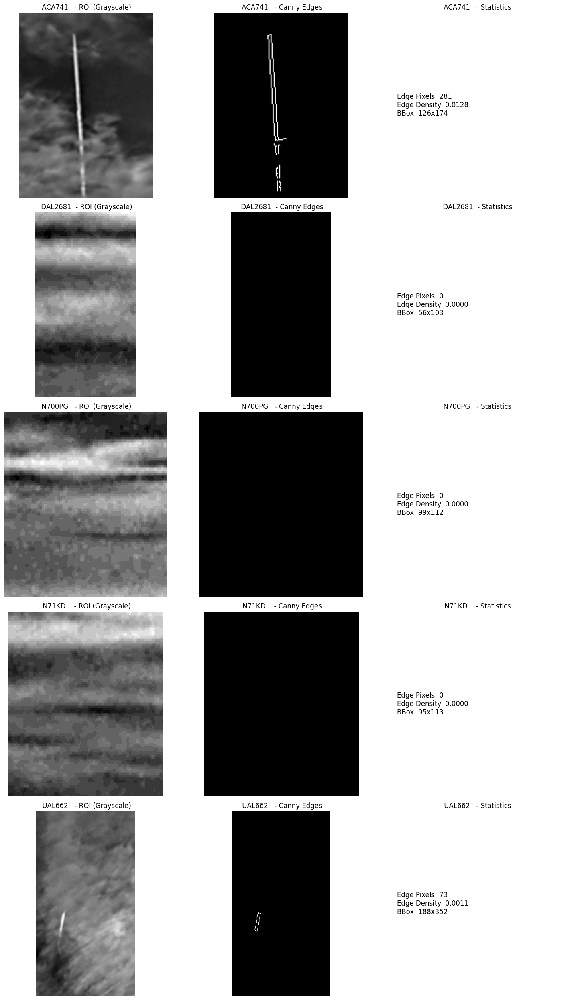

In [463]:
# Visualization: Apply Canny edge detection to directional rectangles
import matplotlib.pyplot as plt

# Use the same test image and time
time_to_check = pd.Timestamp("2025-10-01 10:39:59", tz="America/Chicago").tz_convert("UTC")
print(f"Processing image at UTC time: {time_to_check}")

# Load image
img = cv2.imread(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{image_df[image_df['time'] == time_to_check]['image_file'].values[0]}")
print(f"Image shape: {img.shape}")
print(df_upsampled[df_upsampled['time'] == time_to_check].head())
df_filtered = df_upsampled[df_upsampled['time'] == time_to_check]

img_output, rectangles, edge_data= process_image_with_canny_edges(
                                f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{image_df[image_df['time'] == time_to_check]['image_file'].values[0]}",
                                timestamp=time_to_check,
                                df_filtered=df_filtered,
                                df_upsampled=df_upsampled,
                                lower_threshold=70,
                                upper_threshold=120)

print(f"\nFound {len(rectangles)} aircraft with directional rectangles")

if len(rectangles) > 0:
    
    # Calculate statistics
    edge_stats = calculate_edge_statistics(edge_data)
    print(edge_stats)

    # Visualize: Draw rectangles and overlay edges
    img_visualization = img.copy()
    
    for ident, (rect_poly, arrow, direction_info) in rectangles.items():
        # Draw rectangle outline
        cv2.polylines(img_visualization, [rect_poly], isClosed=True, color=(255, 0, 0), thickness=2)
        
        # Draw arrow if available
        if arrow:
            tip, base = arrow
            cv2.arrowedLine(img_visualization, base, tip, (255, 255, 0), 2, tipLength=0.3)
        
        # Add label
        rect_center = np.mean(rect_poly, axis=0).astype(int)
        cv2.putText(img_visualization, str(ident), tuple(rect_center), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    
    # Create figure with subplots
    fig, axes = plt.subplots(3, 1, figsize=(200, 200))
    
    # Original image with rectangles
    axes[0].imshow(cv2.cvtColor(img_visualization, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image with Directional Rectangles')
    axes[0].axis('off')
    
    # Image with edge overlay
    axes[1].imshow(cv2.cvtColor(img_output, cv2.COLOR_BGR2RGB))
    axes[1].set_title('Canny Edges Detected in Rectangles')
    axes[1].axis('off')
    
    # Combined: Rectangles + Edges
    img_combined = img.copy()
    for ident, (rect_poly, arrow, direction_info) in rectangles.items():
        cv2.polylines(img_combined, [rect_poly], isClosed=True, color=(255, 0, 0), thickness=2)
    # Overlay edges
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    for ident, data in edge_data.items():
        edges_final = data['edges']
        bbox = data['bbox']
        x, y, w, h = bbox
        # Overlay edges on the combined image
        img_combined[y:y+h, x:x+w][edges_final > 0] = (0, 255, 0)  # Green edges
    
    axes[2].imshow(cv2.cvtColor(img_combined, cv2.COLOR_BGR2RGB))
    axes[2].set_title('Rectangles + Detected Edges')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Display individual ROI edge images for each aircraft
    if len(edge_stats) > 0:
        n_aircraft = len(edge_stats)
        fig, axes = plt.subplots(n_aircraft, 3, figsize=(15, 5*n_aircraft))
        
        if n_aircraft == 1:
            axes = axes.reshape(1, -1)
        
        for idx, (ident, data) in enumerate(edge_data.items()):
            # ROI grayscale
            axes[idx, 0].imshow(data['roi'], cmap='gray')
            axes[idx, 0].set_title(f'{ident} - ROI (Grayscale)')
            axes[idx, 0].axis('off')
            
            # Edges
            axes[idx, 1].imshow(data['edges'], cmap='gray')
            axes[idx, 1].set_title(f'{ident} - Canny Edges')
            axes[idx, 1].axis('off')
            
            # Statistics text
            stats_text = f"Edge Pixels: {data['edge_pixel_count']}\n"
            stats_text += f"Edge Density: {data['edge_density']:.4f}\n"
            stats_text += f"BBox: {data['bbox'][2]}x{data['bbox'][3]}"
            axes[idx, 2].text(0.1, 0.5, stats_text, fontsize=12, verticalalignment='center')
            axes[idx, 2].set_title(f'{ident} - Statistics')
            axes[idx, 2].axis('off')
        
        plt.tight_layout()
        plt.show()
else:
    print("No aircraft found with sufficient tracking data for this timestamp.")

In [464]:
import cv2

# Define video parameters
output_path = 'output_video_east_cleaned_contrails.mp4'
img_def = cv2.imread(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{image_df.iloc[0]['image_file']}")
frame_height, frame_width = img_def.shape[0], img_def.shape[1]
fps = 10  # frames per second

# Create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

for idx, row in image_df[:50].iterrows():
    df_filtered = df_upsampled[df_upsampled['time'] == row['time']]

    for ident_g, image_x, image_y in zip(df_filtered['ident'], df_filtered['image_x'], df_filtered['image_y']):
        img = cv2.imread(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{row['image_file']}")
        
        print(ident_g, image_x, image_y, img.shape)
        if not np.isnan(image_x) and not np.isnan(image_y) and 0 <= image_x < img.shape[1] and 0 <= image_y < img.shape[0]:
            cv2.circle(img, (int(image_x), int(image_y)), 5, (0, 0, 255), -1)
            cv2.putText(img, str(ident_g), (int(image_x), int(image_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
    video_writer.write(img)

video_writer.release()
print(f"Video saved to {output_path}")

 N504WV   nan nan (1944, 2592, 3)
 UAL2232  409024224.0 111166144.0 (1944, 2592, 3)
 N504WV   nan nan (1944, 2592, 3)
 UAL2232  61378670592.0 16680188928.0 (1944, 2592, 3)
 N504WV   nan nan (1944, 2592, 3)
 UAL2232  4.775531546839498e+20 1.29755047247613e+20 (1944, 2592, 3)
 N504WV   nan nan (1944, 2592, 3)
 UAL2232  nan nan (1944, 2592, 3)
 DAL2716  1616.0814208984375 1077.48876953125 (1944, 2592, 3)
 N504WV   nan nan (1944, 2592, 3)
 UAL2232  nan nan (1944, 2592, 3)
 DAL2716  1629.66943359375 1068.5543212890625 (1944, 2592, 3)
 N504WV   nan nan (1944, 2592, 3)
 UAL2232  nan nan (1944, 2592, 3)
 DAL2716  1644.1060791015625 1058.6610107421875 (1944, 2592, 3)
 N504WV   nan nan (1944, 2592, 3)
 UAL2232  nan nan (1944, 2592, 3)
 DAL2716  1659.6978759765625 1047.8953857421875 (1944, 2592, 3)
 UAL2232  nan nan (1944, 2592, 3)
 DAL2716  1676.6163330078125 1036.1690673828125 (1944, 2592, 3)
 UAL2232  nan nan (1944, 2592, 3)
 DAL2716  1694.748779296875 1023.917724609375 (1944, 2592, 3)
 UAL223

In [ ]:
import cv2

# Define video parameters
output_path = 'output_video_east_cleaned_2.mp4'
img_def = cv2.imread(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{image_df.iloc[0]['image_file']}")
frame_height, frame_width = img_def.shape[0], img_def.shape[1]
fps = 10  # frames per second

# Create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

for idx, row in image_df.iterrows():
    # img = cv2.imread(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{row['image_file']}")
    # if img is None:
    #     print(f"Could not read image {row['image_file']}")
    #     continue
    df_filtered = df_upsampled[df_upsampled['time'] == row['time']]
    img_o, rectangles, edge_data= process_image_with_canny_edges(f"/Users/shrenikborad/Downloads/NNDL/images_uwisc/east/2025-10-01/east/{row['image_file']}",
                                timestamp=row['time'],
                                df_filtered=df_filtered,
                                df_upsampled=df_upsampled,
                                lower_threshold=70,
                                upper_threshold=120)
    for ident, (rect_poly, arrow, direction_info) in rectangles.items():
        # Draw rectangle outline
        color = (255, 0, 0)  # Blue for normal
        if edge_data[ident]['is_making_contrails']:
            color = (0, 255, 255)  # Yellow for contrails
        cv2.polylines(img_o, [rect_poly], isClosed=True, color=color, thickness=2)

        # Draw arrow if available
        if arrow:
            tip, base = arrow
            # if tip and base:
            #     cv2.arrowedLine(img_output, base, tip, (255, 255, 0), 2, tipLength=0.3)
    img = img_o
    for ident, image_x, image_y in zip(df_filtered['ident'], df_filtered['image_x'], df_filtered['image_y']):
        if not np.isnan(image_x) and not np.isnan(image_y) and 0 <= image_x < img.shape[1] and 0 <= image_y < img.shape[0]:
            cv2.circle(img, (int(image_x), int(image_y)), 5, (0, 0, 255), -1)
            cv2.putText(img, str(ident), (int(image_x), int(image_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
    video_writer.write(img)

video_writer.release()
print(f"Video saved to {output_path}")

Premature end of JPEG file


Video saved to output_video_east_cleaned_2.mp4


: 

3960